In [1]:
import pandas as pd
import numpy as np 
import matplotlib.pyplot as plt
import seaborn as sns



In [2]:
barcelona_airbnb = pd.read_csv("listings (1).csv")
barcelona_airbnb

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,license
0,17475,Rental unit in 08013 Barcelona · ★4.40 · 1 bed...,65623,Luca,Eixample,la Dreta de l'Eixample,41.399390,2.170440,Entire home/apt,140.0,5,26,2023-12-04,0.16,1,32,9,NaN
1,18674,Rental unit in Barcelona · ★4.33 · 3 bedrooms ...,71615,Mireia Maria,Eixample,la Sagrada Família,41.405560,2.172620,Entire home/apt,121.0,1,40,2023-11-07,0.31,30,39,7,HUTB-002062
2,198958,Rental unit in Barcelona · ★4.69 · 4 bedrooms ...,971768,Laura,Sant Martí,Diagonal Mar i el Front Marítim del Poblenou,41.408050,2.214870,Entire home/apt,304.0,2,105,2023-10-16,0.74,9,137,26,HUTB-000926
3,23197,Rental unit in Sant Adria de Besos · ★4.77 · 3...,90417,Etain (Marnie),Sant Martí,el Besòs i el Maresme,41.412432,2.219750,Entire home/apt,200.0,3,75,2023-11-25,0.48,2,300,11,HUTB005057
4,32711,Rental unit in Barcelona · ★4.48 · 2 bedrooms ...,135703,Nick,Gràcia,el Camp d'en Grassot i Gràcia Nova,41.405660,2.170150,Entire home/apt,79.0,1,99,2023-10-18,0.66,3,297,16,HUTB-001722
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18316,1042002618810922779,Rental unit in Barcelona · ★New · 2 bedrooms ·...,3556337,Alejandro,Eixample,l'Antiga Esquerra de l'Eixample,41.388694,2.162324,Entire home/apt,143.0,1,0,NaN,NaN,51,364,0,HUTB-007296
18317,1042044489456901435,Rental unit in Barcelona · ★New · 3 bedrooms ·...,93833963,Maria,Horta-Guinardó,el Guinardó,41.422690,2.176110,Private room,96.0,32,0,NaN,NaN,6,268,0,Exempt
18318,1042051147106602685,Rental unit in Barcelona · ★New · 2 bedrooms ·...,66296022,Toni,Ciutat Vella,la Barceloneta,41.380426,2.191397,Entire home/apt,75.0,32,0,NaN,NaN,12,364,0,NaN
18319,1042053373256947884,Rental unit in Barcelona · ★New · 1 bedroom · ...,478007968,Morge,Eixample,la Sagrada Família,41.401691,2.176437,Private room,70.0,2,0,NaN,NaN,23,266,0,HUTB-784673


In [16]:
barcelona_airbnb.shape


(16056, 13)

In [4]:
barcelona_airbnb.dtypes

id                                  int64
name                               object
host_id                             int64
host_name                          object
neighbourhood_group                object
neighbourhood                      object
latitude                          float64
longitude                         float64
room_type                          object
price                             float64
minimum_nights                      int64
number_of_reviews                   int64
last_review                        object
reviews_per_month                 float64
calculated_host_listings_count      int64
availability_365                    int64
number_of_reviews_ltm               int64
license                            object
dtype: object

In [5]:
barcelona_airbnb.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18321 entries, 0 to 18320
Data columns (total 18 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   id                              18321 non-null  int64  
 1   name                            18321 non-null  object 
 2   host_id                         18321 non-null  int64  
 3   host_name                       18319 non-null  object 
 4   neighbourhood_group             18321 non-null  object 
 5   neighbourhood                   18321 non-null  object 
 6   latitude                        18321 non-null  float64
 7   longitude                       18321 non-null  float64
 8   room_type                       18321 non-null  object 
 9   price                           16056 non-null  float64
 10  minimum_nights                  18321 non-null  int64  
 11  number_of_reviews               18321 non-null  int64  
 12  last_review                     

In [6]:
barcelona_airbnb.duplicated().sum()
barcelona_airbnb.drop_duplicates(inplace=True)

In [7]:
barcelona_airbnb.isnull().sum()

id                                   0
name                                 0
host_id                              0
host_name                            2
neighbourhood_group                  0
neighbourhood                        0
latitude                             0
longitude                            0
room_type                            0
price                             2265
minimum_nights                       0
number_of_reviews                    0
last_review                       4369
reviews_per_month                 4369
calculated_host_listings_count       0
availability_365                     0
number_of_reviews_ltm                0
license                           5917
dtype: int64

In [8]:
barcelona_airbnb.drop(['name','id','host_name','last_review',"license"], axis=1, inplace=True)
barcelona_airbnb.head()

,host_id,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
0,65623,Eixample,la Dreta de l'Eixample,41.399390,2.17044,Entire home/apt,140.0,5,26,0.16,1,32,9
1,71615,Eixample,la Sagrada Família,41.405560,2.17262,Entire home/apt,121.0,1,40,0.31,30,39,7
2,971768,Sant Martí,Diagonal Mar i el Front Marítim del Poblenou,41.408050,2.21487,Entire home/apt,304.0,2,105,0.74,9,137,26
3,90417,Sant Martí,el Besòs i el Maresme,41.412432,2.21975,Entire home/apt,200.0,3,75,0.48,2,300,11
4,135703,Gràcia,el Camp d'en Grassot i Gràcia Nova,41.405660,2.17015,Entire home/apt,79.0,1,99,0.66,3,297,16


In [9]:
barcelona_airbnb.fillna({'reviews_per_month':0}, inplace=True)
barcelona_airbnb.reviews_per_month.isnull().sum()

0

In [10]:
barcelona_airbnb.dropna(subset=['price'],inplace=True)

In [11]:
barcelona_airbnb.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 16056 entries, 0 to 18320
Data columns (total 13 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   host_id                         16056 non-null  int64  
 1   neighbourhood_group             16056 non-null  object 
 2   neighbourhood                   16056 non-null  object 
 3   latitude                        16056 non-null  float64
 4   longitude                       16056 non-null  float64
 5   room_type                       16056 non-null  object 
 6   price                           16056 non-null  float64
 7   minimum_nights                  16056 non-null  int64  
 8   number_of_reviews               16056 non-null  int64  
 9   reviews_per_month               16056 non-null  float64
 10  calculated_host_listings_count  16056 non-null  int64  
 11  availability_365                16056 non-null  int64  
 12  number_of_reviews_ltm           

In [12]:
barcelona_airbnb['price'].isnull().sum()

0

In [13]:
barcelona_airbnb.describe()

,host_id,latitude,longitude,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
count,1.605600e+04,16056.000000,16056.000000,16056.000000,16056.000000,16056.000000,16056.000000,16056.000000,16056.000000,16056.000000
mean,1.798325e+08,41.391703,2.166902,126.494083,15.876682,48.184542,1.222225,38.219856,194.509342,13.391941
std,1.815736e+08,0.013657,0.017285,548.481873,32.831360,94.347352,1.837299,69.565191,129.051319,25.030324
min,1.070400e+04,41.352720,2.085593,9.000000,1.000000,0.000000,0.000000,1.000000,0.000000,0.000000
25%,9.400556e+06,41.381050,2.156774,50.000000,1.000000,1.000000,0.060000,2.000000,72.000000,0.000000
50%,1.168451e+08,41.389511,2.168030,87.000000,3.000000,8.000000,0.520000,7.000000,214.000000,3.000000
75%,3.463675e+08,41.400881,2.177330,130.000000,31.000000,52.000000,1.880000,35.000000,320.000000,19.000000
max,5.496387e+08,41.459560,2.227710,56815.000000,1124.000000,1941.000000,67.300000,318.000000,365.000000,1065.000000


In [17]:
barcelona_airbnb.columns

Index(['host_id', 'neighbourhood_group', 'neighbourhood', 'latitude',
       'longitude', 'room_type', 'price', 'minimum_nights',
       'number_of_reviews', 'reviews_per_month',
       'calculated_host_listings_count', 'availability_365',
       'number_of_reviews_ltm'],
      dtype='object')

In [14]:
#statistical analysis for my target col
barcelona_airbnb[["price","minimum_nights"]].describe()

,price,minimum_nights
count,16056.000000,16056.000000
mean,126.494083,15.876682
std,548.481873,32.831360
min,9.000000,1.000000
25%,50.000000,1.000000
50%,87.000000,3.000000
75%,130.000000,31.000000
max,56815.000000,1124.000000


By analyzing columns price and minimum_nights, one can verify that in 75% of properties listed, rent price is below 130 euros, but the maximum value reaches 56815 euros! On the same way, in 75% of them, minimum number of nights is below 31 days, but maximum value is 1124!

Next, we will plot a histogram of numerical variables.

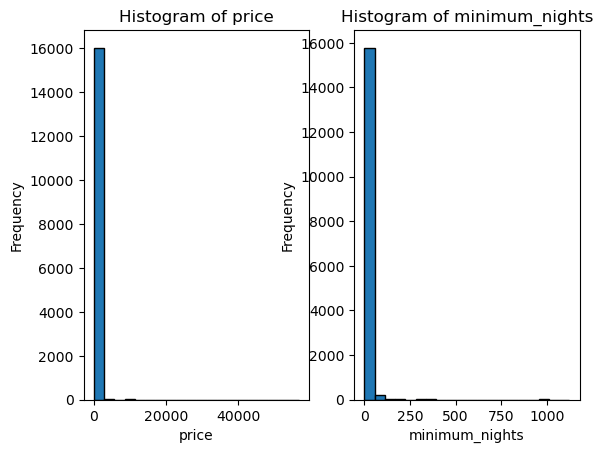

In [26]:
plt.subplot(1,2,1)
plt.hist(barcelona_airbnb["price"], bins=20, edgecolor='black')
plt.xlabel("price")
plt.ylabel('Frequency')
plt.title(f'Histogram of {"price"}')
plt.subplot(1,2,2)
plt.hist(barcelona_airbnb["minimum_nights"], bins=20, edgecolor='black')
plt.xlabel("minimum_nights")
plt.ylabel('Frequency')
plt.title(f'Histogram of {"minimum_nights"}')
  # Display the histogram
plt.show()

# As we can see, almost all data from these columns are concentrated on the left side, which is an evidence that there are outliers on them.

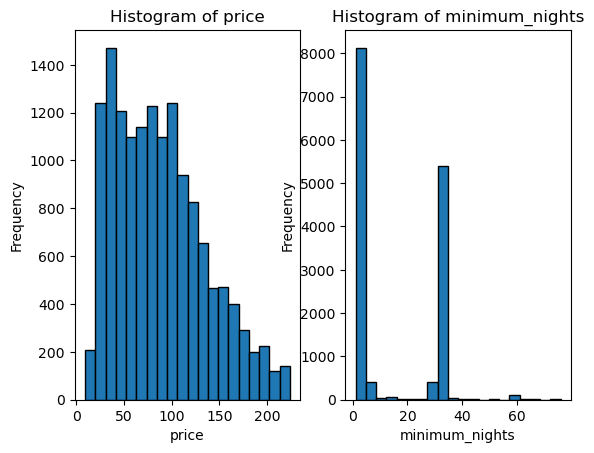

In [31]:
def remove_outliers(data, column):
    Q1 = data[column].quantile(0.25)
    Q3 = data[column].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    return data[(data[column] >= lower_bound) & (data[column] <= upper_bound)]

# Remove outliers from both price and minimum_nights
barcelona_airbnb = remove_outliers(barcelona_airbnb, "price")
barcelona_airbnb = remove_outliers(barcelona_airbnb, "minimum_nights")
# Histogram for price and minimum_nights without outliers

plt.subplot(1,2,1)
plt.hist(barcelona_airbnb["price"], bins=20, edgecolor='black')
plt.xlabel("price")
plt.ylabel('Frequency')
plt.title(f'Histogram of {"price"}')
plt.subplot(1,2,2)
plt.hist(barcelona_airbnb["minimum_nights"], bins=20, edgecolor='black')
plt.xlabel("minimum_nights")
plt.ylabel('Frequency')
plt.title(f'Histogram of {"minimum_nights"}')
  # Display the histogram
plt.show()

now using a histogram, we can see how the prices are distributed, we notice that the largest concentration of values is below 100 

In [33]:
barcelona_airbnb[["price","minimum_nights"]].describe()

,price,minimum_nights
count,14663.000000,14663.000000
mean,87.861965,14.490691
std,47.571737,15.068888
min,9.000000,1.000000
25%,48.500000,1.000000
50%,81.000000,3.000000
75%,119.000000,31.000000
max,224.000000,76.000000


Average price and minimum of nights after removing outliers:
Average of minimum of nights: 14.49
Average of price: 87.86

In [34]:
barcelona_airbnb.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 14663 entries, 0 to 18320
Data columns (total 13 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   host_id                         14663 non-null  int64  
 1   neighbourhood_group             14663 non-null  object 
 2   neighbourhood                   14663 non-null  object 
 3   latitude                        14663 non-null  float64
 4   longitude                       14663 non-null  float64
 5   room_type                       14663 non-null  object 
 6   price                           14663 non-null  float64
 7   minimum_nights                  14663 non-null  int64  
 8   number_of_reviews               14663 non-null  int64  
 9   reviews_per_month               14663 non-null  float64
 10  calculated_host_listings_count  14663 non-null  int64  
 11  availability_365                14663 non-null  int64  
 12  number_of_reviews_ltm           

C:\Users\User\AppData\Local\Temp\ipykernel_14968\2121114680.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corr = barcelona_airbnb.corr(method='kendall')


<Axes: >

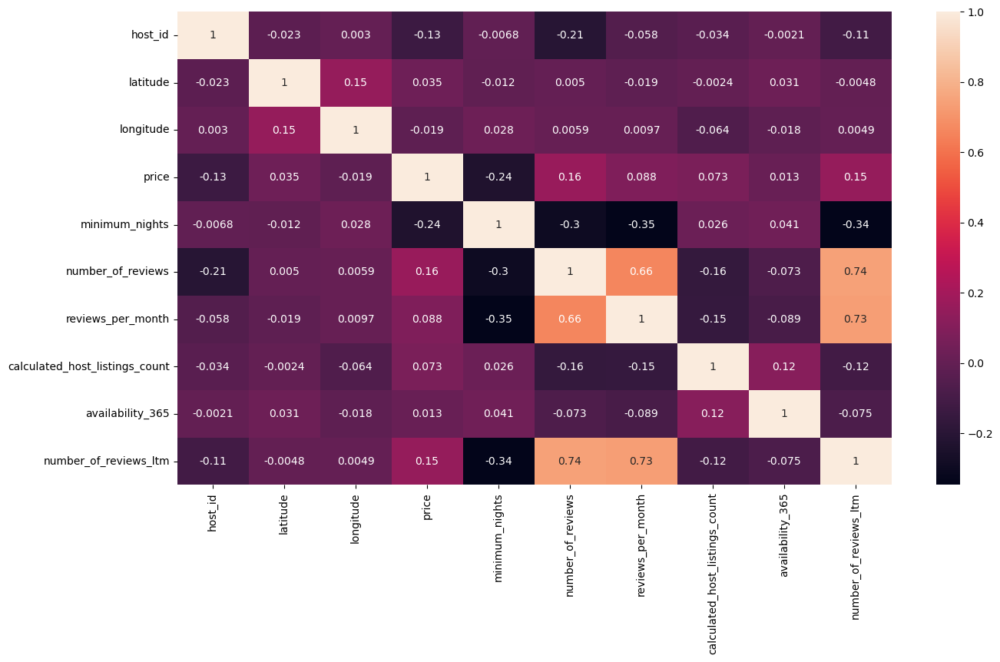

In [37]:
corr = barcelona_airbnb.corr(method='kendall')
plt.figure(figsize=(15,8))
sns.heatmap(corr, annot=True)

there is no good correlation we can use especially with the price

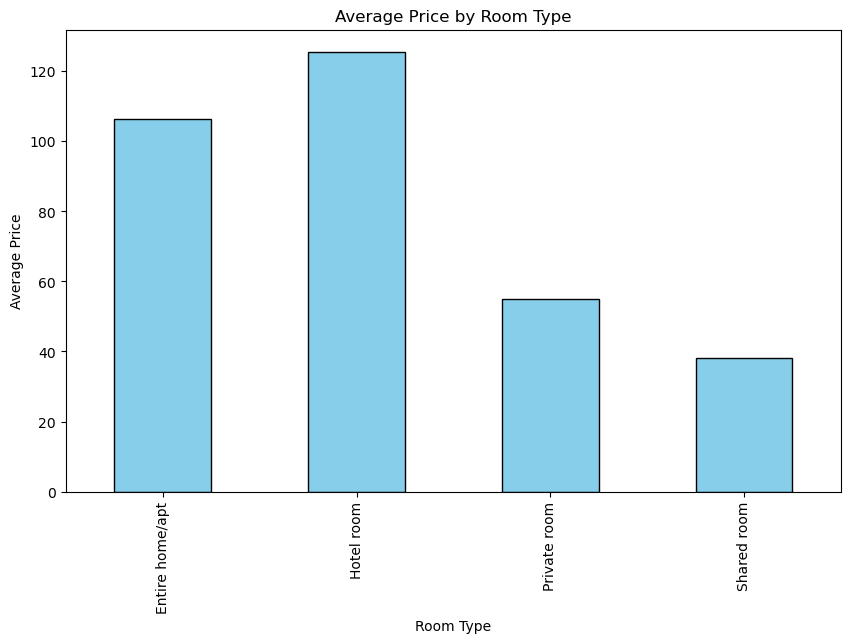

In [35]:
average_prices = barcelona_airbnb.groupby("room_type")["price"].mean()

# Create a bar plot to visualize average price by room type
plt.figure(figsize=(10, 6))
average_prices.plot(kind='bar', color='skyblue', edgecolor='black')
plt.xlabel("Room Type")
plt.ylabel("Average Price")
plt.title("Average Price by Room Type")
plt.show()

Text(0.5, 1.0, 'Most types of rooms for rent')

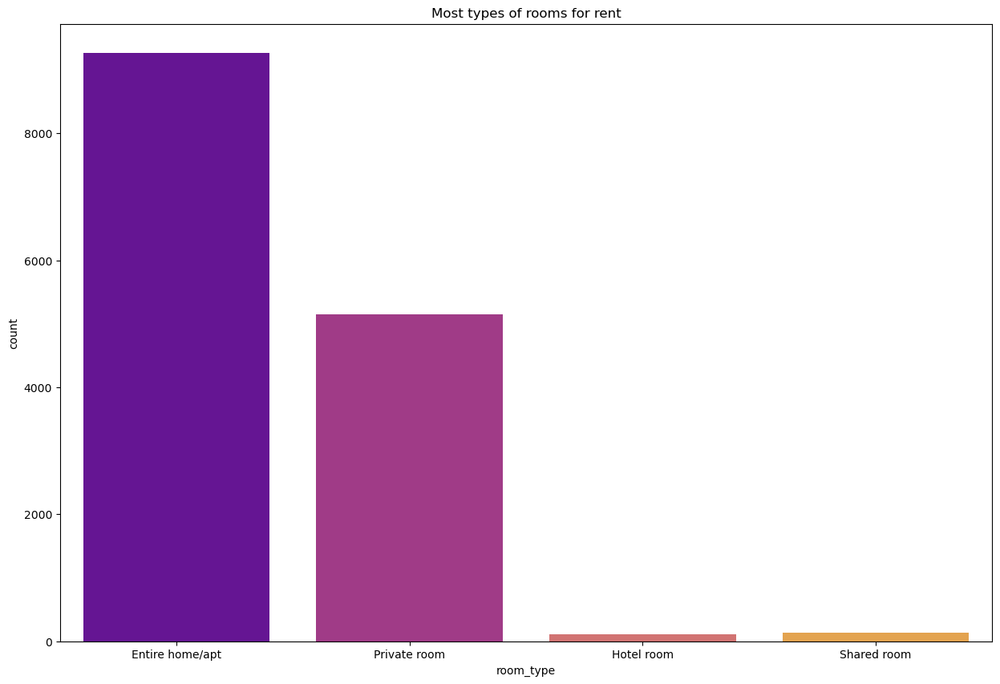

In [36]:
sns.countplot(data=barcelona_airbnb, x='room_type', palette="plasma")
fig = plt.gcf()
fig.set_size_inches(15,10)
plt.title('Most types of rooms for rent')

we notice from two upper chart that the most expensive room was the hotel room but not the most rent, the most rent room was the entire home

In [39]:
barcelona_airbnb["neighbourhood_group"].unique()

array(['Eixample', 'Sant Martí', 'Gràcia', 'Ciutat Vella',
       'Sants-Montjuïc', 'Sarrià-Sant Gervasi', 'Sant Andreu',
       'Les Corts', 'Horta-Guinardó', 'Nou Barris'], dtype=object)

In [40]:
barcelona_airbnb["neighbourhood"].unique()

array(["la Dreta de l'Eixample", 'la Sagrada Família',
       'el Besòs i el Maresme', "el Camp d'en Grassot i Gràcia Nova",
       "l'Antiga Esquerra de l'Eixample", 'el Barri Gòtic',
       'la Vila de Gràcia', 'el Poble Sec', 'la Barceloneta',
       'Sant Pere, Santa Caterina i la Ribera', 'el Fort Pienc',
       'Sant Gervasi - Galvany', 'el Raval', 'el Poblenou', 'el Clot',
       'Sant Martí de Provençals', 'Navas', 'Vallcarca i els Penitents',
       'Sants', 'Pedralbes', 'el Guinardó', 'Sant Antoni',
       "la Nova Esquerra de l'Eixample", 'Sarrià', 'el Coll',
       'el Parc i la Llacuna del Poblenou',
       'la Vila Olímpica del Poblenou', 'Sants - Badal',
       'el Baix Guinardó', 'el Congrés i els Indians',
       'Diagonal Mar i el Front Marítim del Poblenou', 'la Bordeta',
       'el Putxet i el Farró', 'Hostafrancs',
       'la Maternitat i Sant Ramon', 'les Corts',
       'Provençals del Poblenou', "la Font d'en Fargues", 'el Carmel',
       'la Salut', 'la Font de 

In [42]:
!pip install folium

  Obtaining dependency information for folium from https://files.pythonhosted.org/packages/b9/98/9ba4b9d2d07dd32765ddb4e4c189dcbdd7dca4d5a735e2e4ea756f40c36b/folium-0.16.0-py2.py3-none-any.whl.metadata
  Obtaining dependency information for branca>=0.6.0 from https://files.pythonhosted.org/packages/17/ce/14166d0e273d12065516625fb02426350298e7b4ba59198b5fe454b46202/branca-0.7.1-py3-none-any.whl.metadata
   ---------------------------------------- 0.0/100.0 kB ? eta -:--:--
   ---------------- ----------------------- 41.0/100.0 kB ? eta -:--:--
   ---------------- ----------------------- 41.0/100.0 kB ? eta -:--:--
   ------------------------------- ------- 81.9/100.0 kB 651.6 kB/s eta 0:00:01
   -------------------------------------- 100.0/100.0 kB 636.7 kB/s eta 0:00:00


In [43]:
import pandas as pd
import folium
from folium.plugins import MarkerCluster

# Create a base map centered on Barcelona
barcelona_map = folium.Map(location=[41.3851, 2.1734], zoom_start=12)  # Coordinates for Barcelona

# Use MarkerCluster to group nearby markers
marker_cluster = MarkerCluster().add_to(barcelona_map)

# Add markers for each listing with colour coded by neighbourhood_group
for _, row in barcelona_airbnb.iterrows():
    folium.Marker(
        location=[row["latitude"], row["longitude"]],
        popup=f"Neighbourhood Group: {row['neighbourhood_group']}\nPrice: {row['price']}",
        icon=folium.Icon(color='blue', icon='info-sign'),  # Customize icon as needed
    ).add_to(marker_cluster)

# Display the map
barcelona_map.save("barcelona_airbnb_map.html")
barcelona_map  # In Jupyter or similar environments, this should display the map


in this map, you can see that most listings are in the Eixample

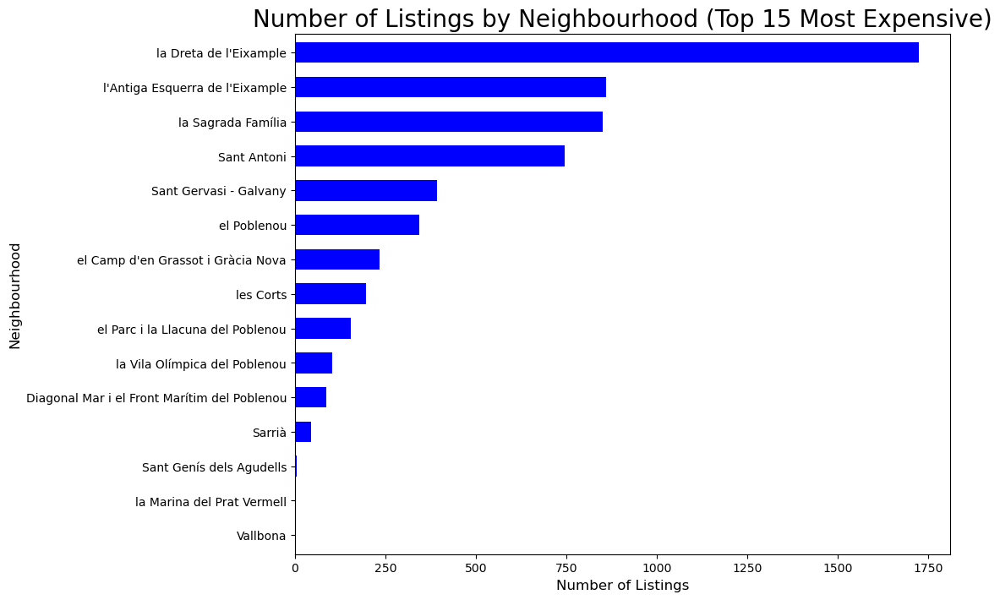

In [58]:
import pandas as pd
import matplotlib.pyplot as plt

# Ensure price is numeric
barcelona_airbnb["price"] = barcelona_airbnb["price"].replace('[\$,€]', '', regex=True).astype(float)

# Step 1: Calculate the average price for each neighbourhood
average_price_by_neighbourhood = barcelona_airbnb.groupby("neighbourhood")["price"].mean()

# Step 2: Get the top 15 most expensive neighbourhoods
top_15_expensive_neighbourhoods = average_price_by_neighbourhood.sort_values(ascending=False).head(15)

# Step 3: Filter the original data to include only these top 15 neighbourhoods
top_15_data = barcelona_airbnb[barcelona_airbnb["neighbourhood"].isin(top_15_expensive_neighbourhoods.index)]

# Step 4: Get the count of listings for these top 15 neighbourhoods
feq = top_15_data['neighbourhood'].value_counts().sort_values(ascending=True)

# Step 5: Create a horizontal bar plot
feq.plot.barh(figsize=(10, 8), color='b', width=0.6)  # Horizontal bar plot
plt.title("Number of Listings by Neighbourhood (Top 15 Most Expensive)", fontsize=20)
plt.xlabel('Number of Listings', fontsize=12)
plt.ylabel('Neighbourhood', fontsize=12)  # Add y-axis label for clarity
plt.show()



Two of the 3 most expensive neighborhoods (la Dreta and l’Antiga Esquerra) belongs to Eixample district. this neighborhoods has a high population density.

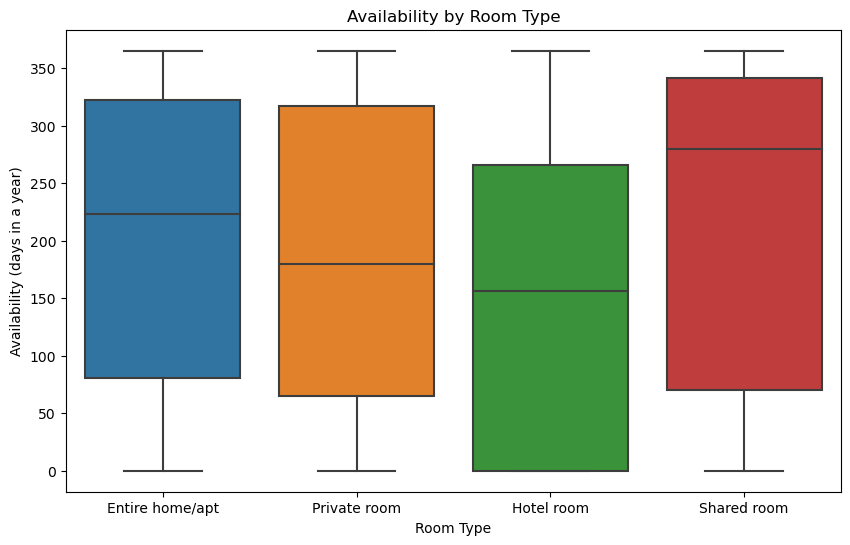

In [59]:
# Box plot to compare availability across room types
plt.figure(figsize=(10, 6))
sns.boxplot(data=barcelona_airbnb, x="room_type", y="availability_365")
plt.xlabel("Room Type")
plt.ylabel("Availability (days in a year)")
plt.title("Availability by Room Type")
plt.show()


here we notice that the Hotel room has less availability Because it is more popular

# In the end i recommending a decision-makers to focus on Eixample neighbourhood_group Because it is the most visited and the most populated